In [67]:
using CSV, DataFrames, Plots, Statistics, JuMP, Gurobi, StatsBase

In [68]:
pollution = DataFrame(CSV.File("Data/pollution_location.csv"))
pollution_xy = pollution[:,1:2]|>Matrix
densities = DataFrame(CSV.File("Data/density_location.csv"))
sensors = DataFrame(CSV.File("Data/sensors_location.csv"))
sensors_xy = sensors[:,1:2]|>Matrix;

In [69]:
lat_to_km = [111, 92]
lat_diff = (pollution_xy[:,1].-sensors_xy[:,1]').*lat_to_km[1]
long_diff = (pollution_xy[:,2].-sensors_xy[:,2]').*lat_to_km[2]

dist_matrix = sqrt.(lat_diff.^2 + long_diff.^2)';
rows_to_keep = findall(row -> any(iszero, row), eachrow(dist_matrix))
dist_matrix = dist_matrix[rows_to_keep, :]
sensors_xy = sensors_xy[rows_to_keep, :];

In [70]:
density

density (generic function with 1 method)

In [71]:
dens = densities.density
dens = max.(dens,0.333)
r1 = 0
r2 = 3
r3 = 10
d1 = ((dist_matrix' .* dens)' .<= r1)
d2 = (r1 .< (dist_matrix' .* dens)' .<= r2)
d3 = (r2 .< (dist_matrix' .* dens)' .<= r3)
q = pollution.AIQ
p = 150

n, m = size(dist_matrix)

(1780, 7107)

In [72]:
q_sen = (dist_matrix.==0) * q
function loss(x, q, k)
    x = round.(x)
    d = 1 ./(dist_matrix .+ 10 .*(1 .-x) .* maximum(dist_matrix) .+ 1)
    dq = d .* q_sen
    q_pred = zeros(size(q))
    for j = 1:size(q, 1)
        indices = partialsortperm(d[:,j], 1:k, rev=true)
        if d[indices[1], j]==1
            q_pred[j] = q_sen[indices[1]]
        else
            q_pred[j] = sum(dq[indices, j].*x[indices])/sum(d[indices, j].*x[indices])
        end
    end
    return sum((q_pred - q).^2)/sum(q.^2)
end


loss (generic function with 1 method)

In [73]:
function model2(mu)
    model = Model(Gurobi.Optimizer);
    set_optimizer_attribute(model, "MIPGap", 0.05);
    set_optimizer_attribute(model, "TimeLimit", 60);
    
    @variable(model, x[1:n], Bin) #Whether we put a sensor at spot i
    @variable(model, y1[1:m].<=1) #Whether spot j is covered closely
    @variable(model, y2[1:m].<=1) #Whether spot j is covered at a distance
    @variable(model, y3[1:m].<=1) #Whether spot j is covered at a distance
    
    @constraint(model, y1'.<= x'*d1)
    @constraint(model, y2'.<= x'*d2)
    @constraint(model, y3'.<= x'*d3)
    @constraint(model, y1 .+ y2 .+ y3 .==1)
    
    @objective(model, Max, mu*(sum(y1.*q) + 1/8*sum(y2.*q) + 1/200*sum(y3.*q)) - (1-mu)*p*sum(x))
    optimize!(model)
    return value.(x), value.(y1), value.(y2), value.(y3), objective_value(model)
end


model2 (generic function with 1 method)

Set parameter Username
Academic license - for non-commercial use only - expires 2025-08-18
Set parameter MIPGap to value 0.05
Set parameter TimeLimit to value 60
Set parameter MIPGap to value 0.05
Set parameter TimeLimit to value 60
Gurobi Optimizer version 11.0.2 build v11.0.2rc0 (mac64[arm] - Darwin 23.4.0 23E224)

CPU model: Apple M2
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 28428 rows, 23101 columns and 1793667 nonzeros
Model fingerprint: 0x6ffa4f41
Variable types: 21321 continuous, 1780 integer (1780 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e+02, 2e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -188850.0000
Presolve removed 12980 rows and 12977 columns (presolve time = 5s) ...
Presolve removed 12980 rows and 12977 columns
Presolve time: 5.80s
Presolved: 15448 rows, 10124 columns, 1767670 nonzeros
Variable types: 0 cont

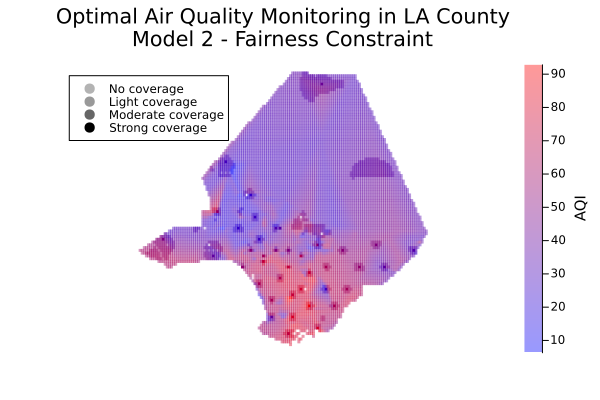

Set parameter Username
Academic license - for non-commercial use only - expires 2025-08-18
Set parameter MIPGap to value 0.05
Set parameter TimeLimit to value 60
Set parameter MIPGap to value 0.05
Set parameter TimeLimit to value 60
Gurobi Optimizer version 11.0.2 build v11.0.2rc0 (mac64[arm] - Darwin 23.4.0 23E224)

CPU model: Apple M2
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 28428 rows, 23101 columns and 1793667 nonzeros
Model fingerprint: 0x3255d5d7
Variable types: 21321 continuous, 1780 integer (1780 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [6e-03, 1e+02]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -155520.2744
Presolve removed 13788 rows and 13011 columns
Presolve time: 3.34s
Presolved: 14640 rows, 10090 columns, 1593354 nonzeros
Found heuristic solution: objective -29766.80758
Variable types: 3118 continuous, 6972 intege

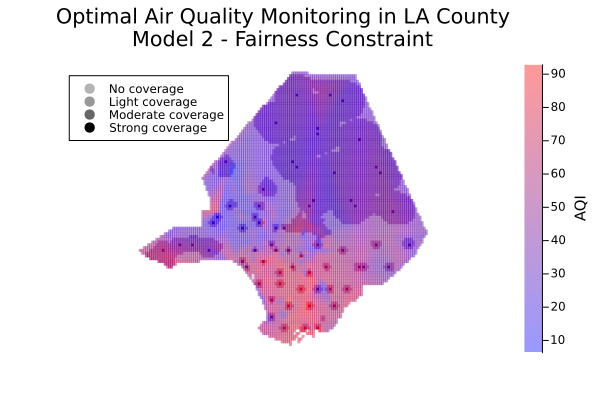

Set parameter Username
Academic license - for non-commercial use only - expires 2025-08-18
Set parameter MIPGap to value 0.05
Set parameter TimeLimit to value 60
Set parameter MIPGap to value 0.05
Set parameter TimeLimit to value 60
Gurobi Optimizer version 11.0.2 build v11.0.2rc0 (mac64[arm] - Darwin 23.4.0 23E224)

CPU model: Apple M2
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 28428 rows, 23101 columns and 1793667 nonzeros
Model fingerprint: 0xda5849f9
Variable types: 21321 continuous, 1780 integer (1780 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e-02, 9e+01]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -122190.5488
Presolve removed 13788 rows and 13011 columns
Presolve time: 3.46s
Presolved: 14640 rows, 10090 columns, 1593354 nonzeros
Found heuristic solution: objective -11533.61516
Variable types: 3118 continuous, 6972 intege

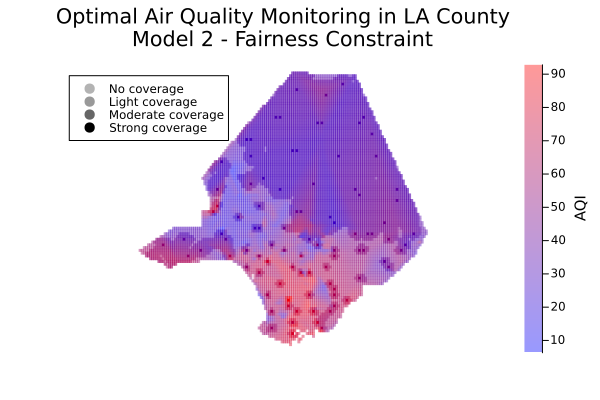

Set parameter Username
Academic license - for non-commercial use only - expires 2025-08-18
Set parameter MIPGap to value 0.05
Set parameter TimeLimit to value 60
Set parameter MIPGap to value 0.05
Set parameter TimeLimit to value 60
Gurobi Optimizer version 11.0.2 build v11.0.2rc0 (mac64[arm] - Darwin 23.4.0 23E224)

CPU model: Apple M2
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 28428 rows, 23101 columns and 1793667 nonzeros
Model fingerprint: 0x30447e05
Variable types: 21321 continuous, 1780 integer (1780 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [2e-02, 6e+01]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -88860.82317
Presolve removed 13951 rows and 13053 columns
Presolve time: 3.69s
Presolved: 14477 rows, 10048 columns, 1590036 nonzeros
Found heuristic solution: objective 6990.1919044
Variable types: 3068 continuous, 6980 intege

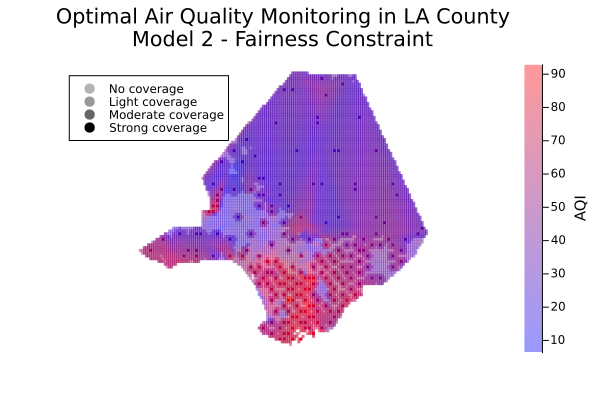

Set parameter Username
Academic license - for non-commercial use only - expires 2025-08-18
Set parameter MIPGap to value 0.05
Set parameter TimeLimit to value 60
Set parameter MIPGap to value 0.05
Set parameter TimeLimit to value 60
Gurobi Optimizer version 11.0.2 build v11.0.2rc0 (mac64[arm] - Darwin 23.4.0 23E224)

CPU model: Apple M2
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 28428 rows, 23101 columns and 1793667 nonzeros
Model fingerprint: 0xebb41494
Variable types: 21321 continuous, 1780 integer (1780 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e-02, 7e+01]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -55531.09756
Presolve removed 26987 rows and 21543 columns
Presolve time: 1.12s
Presolved: 1441 rows, 1558 columns, 46317 nonzeros
Found heuristic solution: objective 37852.944948
Variable types: 26 continuous, 1532 integer (153

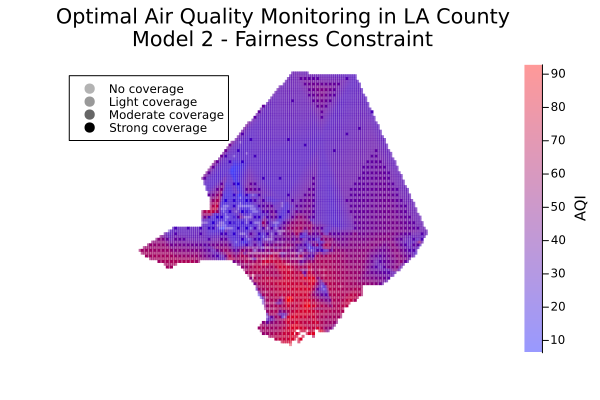

Set parameter Username
Academic license - for non-commercial use only - expires 2025-08-18
Set parameter MIPGap to value 0.05
Set parameter TimeLimit to value 60
Set parameter MIPGap to value 0.05
Set parameter TimeLimit to value 60
Gurobi Optimizer version 11.0.2 build v11.0.2rc0 (mac64[arm] - Darwin 23.4.0 23E224)

CPU model: Apple M2
Thread count: 8 physical cores, 8 logical processors, using up to 8 threads

Optimize a model with 28428 rows, 23101 columns and 1793667 nonzeros
Model fingerprint: 0x1908f794
Variable types: 21321 continuous, 1780 integer (1780 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [3e-02, 9e+01]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective -22201.37196
Presolve removed 28428 rows and 23101 columns
Presolve time: 0.13s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.16 seconds (0.19 work units)
Thread count was 1 (of 8 available

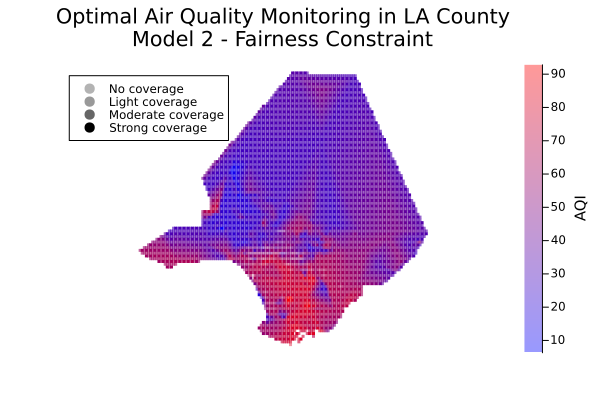

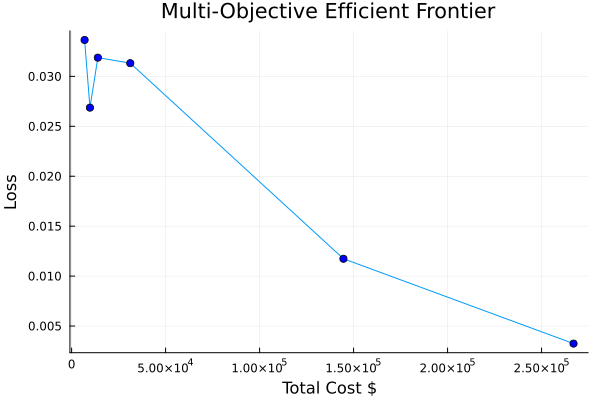

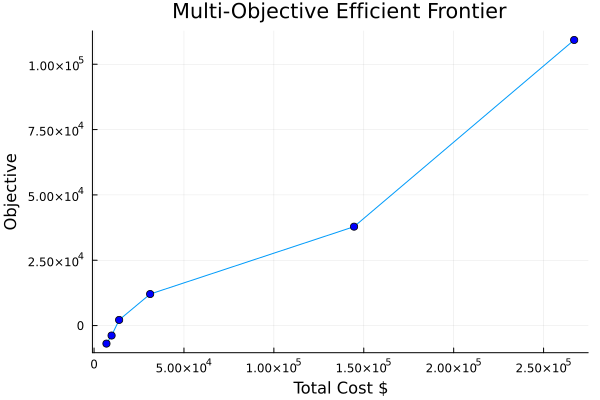

In [ ]:
loss_mu = []
cost_mu = []
obj_mu = []

for mu in 0:0.2:1
    result = model2(mu)
    x, y1, y2, y3, obj = result
    total_loss = loss(x, q, 5)
    total_cost = p*sum(x)
    push!(loss_mu, total_loss)
    push!(cost_mu, total_cost)
    push!(obj_mu, obj)

    s = scatter(pollution_xy[:, 2], pollution_xy[:, 1], 
    marker_z=q, 
    color=cgrad([:blue, :red]), 
    alpha= .3 .+ 0.7 .* y1 + 0.3 .* y2 + 0.1 .* y3 ,
    markersize=1.5, 
    shape=:rect,  
    markerstrokewidth=0,
    label="",
    ratio = 1.1,
    colorbar=true, colorbar_title = "AQI", legend=:topleft, axis = false, grid = false,
    )

    scatter!(s, [NaN], [NaN], alpha = 0.3, color = :black, shape = :circle, label = "No coverage")
    scatter!(s, [NaN], [NaN], alpha = 0.4, color = :black, shape = :circle, label = "Light coverage")
    scatter!(s, [NaN], [NaN], alpha = 0.6, color = :black, shape = :circle, label = "Moderate coverage")
    scatter!(s, [NaN], [NaN], alpha = 1, color = :black, shape = :circle, label = "Strong coverage")

    title!(s, "Optimal Air Quality Monitoring in LA County\nModel 2 - Fairness Constraint (mu = $mu)")

    display(s)
end

p1 = plot(cost_mu, loss_mu, xlabel="Total Cost \$", ylabel="Loss", title="Multi-Objective Efficient Frontier", legend=false)
scatter!(p1,cost_mu, loss_mu, color=:blue, label="Different mu values") 

p2 = plot(cost_mu, obj_mu, xlabel="Total Cost \$", ylabel="Objective", title="Multi-Objective Efficient Frontier", legend=false)
scatter!(p2 , cost_mu, obj_mu, color=:blue, label="Different mu values") 
display(p1)
display(p2)

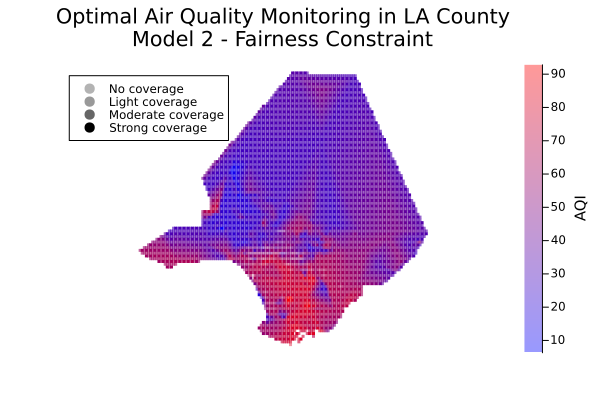

In [75]:
scatter(pollution_xy[:, 2], pollution_xy[:, 1], 
    marker_z=q, 
    color=cgrad([:blue, :red]), 
    alpha= .3 .+ 0.7 .* y1 + 0.3 .* y2 + 0.1 .* y3 ,
    markersize=1.5, 
    shape=:rect,  
    markerstrokewidth=0,
    label="",
    ratio = 1.1,
    colorbar=true, colorbar_title = "AQI", legend=:topleft, axis = false, grid = false,
    )

scatter!([NaN], [NaN], alpha = 0.3, color = :black, shape = :circle, label = "No coverage")
scatter!([NaN], [NaN], alpha = 0.4, color = :black, shape = :circle, label = "Light coverage")
scatter!([NaN], [NaN], alpha = 0.6, color = :black, shape = :circle, label = "Moderate coverage")
scatter!([NaN], [NaN], alpha = 1, color = :black, shape = :circle, label = "Strong coverage")


# Add a title with better formatting
title!("Optimal Air Quality Monitoring in LA County\nModel 2 - Fairness Constraint")

In [76]:
loss(x, q, 5)

0.00323855018760913